<a href="https://colab.research.google.com/github/KeerthiKamarthi/html_file/blob/main/Raw_Mask_Image_Script.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install pycocotools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [4]:
import json
import os
import datetime

import numpy as np
from matplotlib import pyplot as plt
from scipy import ndimage as nd
import imageio as io

import pycocotools
from pycocotools.mask import encode
import pycocotools.coco as coco
from pycocotools.coco import COCO

In [33]:
import numpy as np
import cv2
from pycocotools.coco import COCO
from pycocotools import mask

# Initialize the COCO API
dataDir = '/content/images'
# dataType = 'train2017'
annFile = f'/content/trainval.json'
coco = COCO(annFile)

# Get the category IDs and names
cats = coco.loadCats(coco.getCatIds())
cat_names = [cat['name'] for cat in cats]

# Loop over the images and annotations
for ann in coco.dataset['annotations']:
    # Load the image
    img = cv2.imread(f'/content/images/75bade50-1672664670088.jpeg')

    # Create an empty mask
    mask_arr = np.zeros((img.shape[0], img.shape[1]), dtype=np.uint8)

    # Draw the annotation on the mask
    if ann['iscrowd'] == 0:
        rle = mask.frPyObjects(ann['segmentation'], img.shape[0], img.shape[1])
        mask_arr = np.squeeze(mask.decode(rle))
    else:
        mask_arr = coco.annToMask(ann)

    # Save the mask to disk
    mask_file = f'/content/images/masks/{cat_names[ann["category_id"]]}_{ann["image_id"]}_{ann["id"]}.png'
    # cv2.imwrite(mask_file, mask)
    if mask_arr is not None:
        cv2.imwrite(mask_file, mask_arr)
    else:
        print(f'Error: Failed to generate mask for annotation {ann["id"]}')


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [41]:
import numpy as np
import cv2
from pycocotools.coco import COCO
from pycocotools import mask as COCOmask

# Initialize the COCO API
dataDir = '/content/images'
# dataType = 'train2017'
annFile = f'/content/trainval.json'
coco = COCO(annFile)

# Get the category IDs and names
catIds = coco.getCatIds()
cat_names = [cat['name'] for cat in coco.loadCats(catIds)]

# Define the colors to use for each category
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (255, 0, 255), (0, 255, 255)]

# Loop over the categories and generate a unique color mask for each one
for i, catId in enumerate(catIds):
    # Get the annotations for this category
    annIds = coco.getAnnIds(catIds=catId)
    anns = coco.loadAnns(annIds)

    # Create a blank canvas for the mask
    mask = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)

    # Draw the mask for each annotation in this category
    for ann in anns:
        if ann['iscrowd'] == 1:
            rle = COCOmask.frPyObjects(ann['segmentation'], img.shape[0], img.shape[1])
            binary_mask = np.squeeze(COCOmask.decode(rle))
        else:
            binary_mask = coco.annToMask(ann)

        # Apply the color for this category to the mask
        color = colors[i % len(colors)]
        mask[binary_mask > 0] = color

    # Save the mask to disk
    mask_file = f'/content/images/masks/{cat_names[i]}.png'
    cv2.imwrite(mask_file, np.uint8(mask)*255)


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


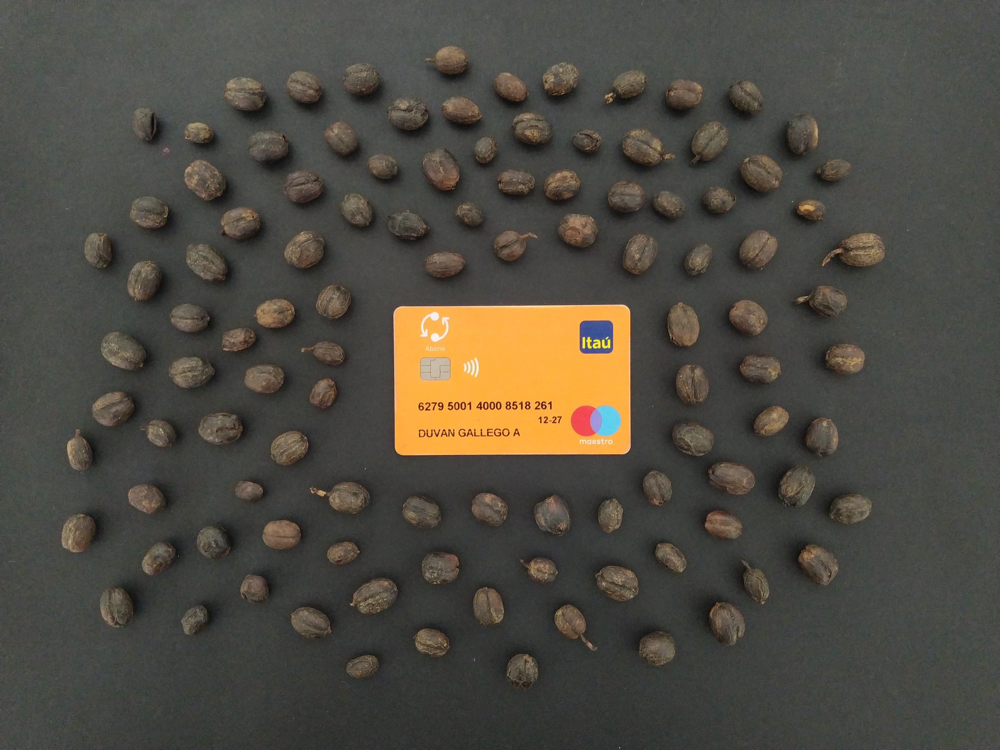

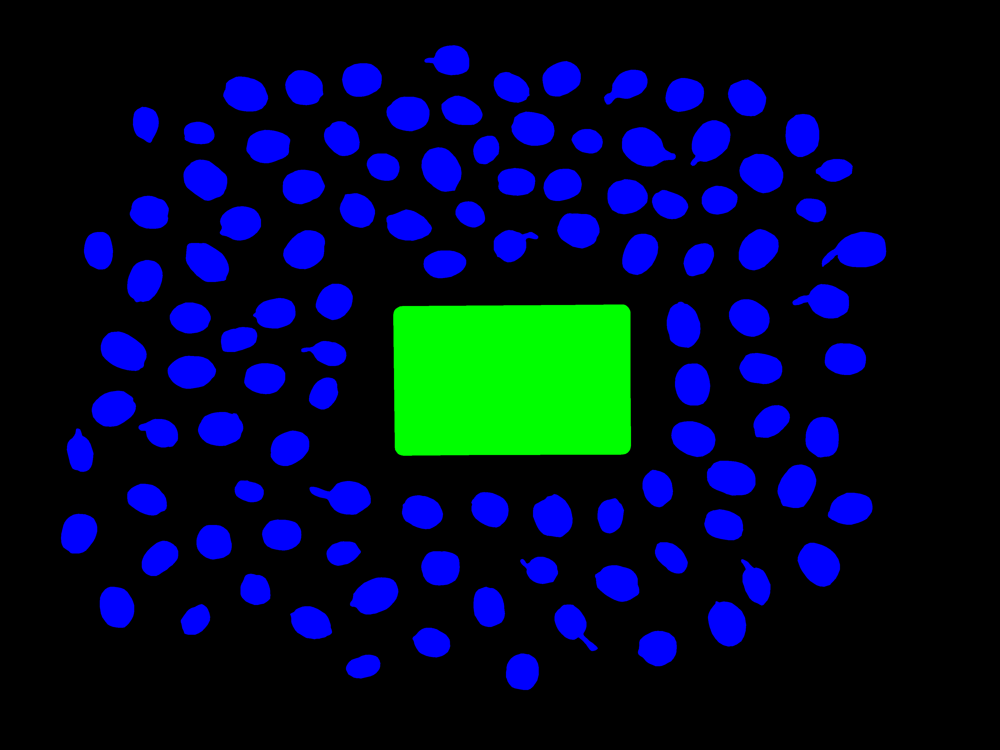

In [46]:
import numpy as np
import cv2
from pycocotools.coco import COCO
from pycocotools import mask as COCOmask
from google.colab.patches import cv2_imshow

# Initialize the COCO API
dataDir = '/content/images'
annFile = f'/content/trainval.json'
coco = COCO(annFile)

# Get the category IDs and names
catIds = coco.getCatIds()
cat_names = [cat['name'] for cat in coco.loadCats(catIds)]

# Define the colors to use for each category
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (255, 0, 255), (0, 255, 255)]

# Load the image
img_dir = '/content/images'
image_id = 0
img = coco.loadImgs(image_id)[0]
image = cv2.imread(os.path.join(img_dir, img['file_name']))

# Show the image
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Get the annotations for this image
annIds = coco.getAnnIds(imgIds=img['id'])
anns = coco.loadAnns(annIds)

# Create a blank canvas for the mask
mask = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)

# Draw the mask for each annotation
for ann in anns:
    if ann['iscrowd'] == 1:
        rle = COCOmask.frPyObjects(ann['segmentation'], image.shape[0], image.shape[1])
        binary_mask = np.squeeze(COCOmask.decode(rle))
    else:
        binary_mask = coco.annToMask(ann)
    
    # Apply the color for this category to the mask
    color = colors[ann['category_id'] % len(colors)]
    mask[binary_mask > 0] = color

# Show the mask
cv2_imshow(mask)
cv2.waitKey(0)
cv2.destroyAllWindows()

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


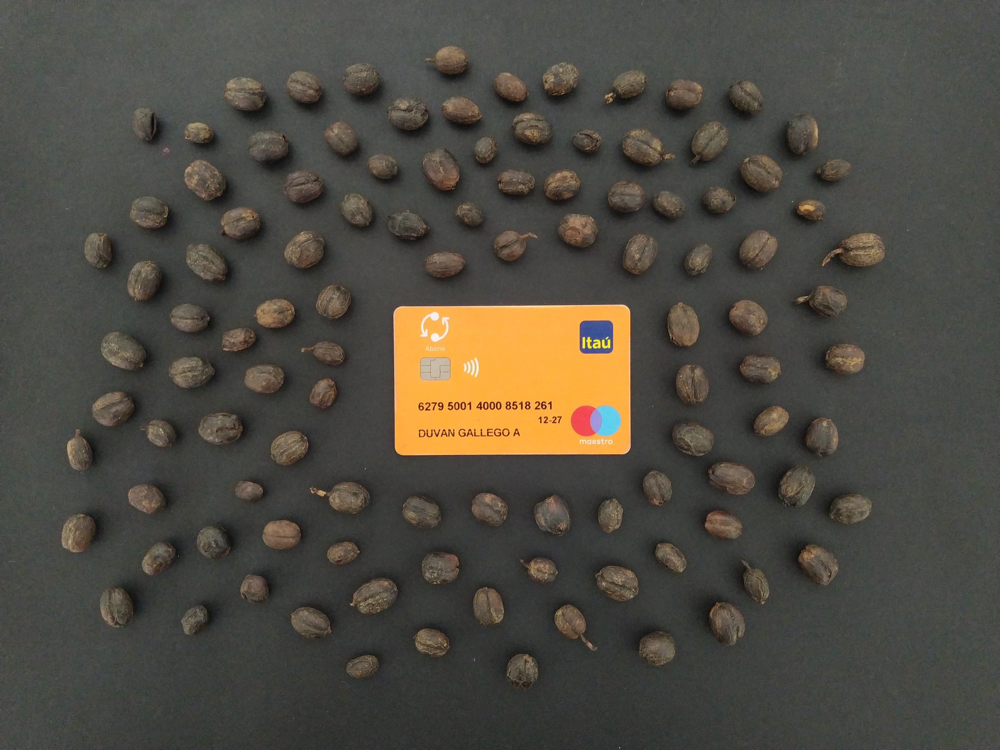

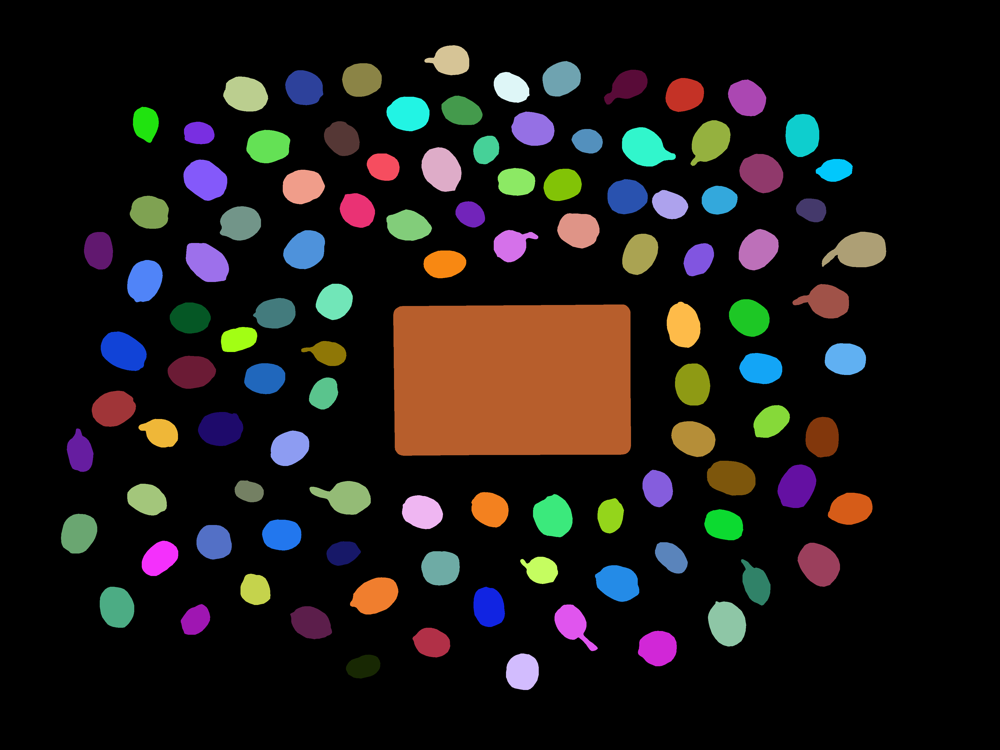

In [47]:
import numpy as np
import cv2
from pycocotools.coco import COCO
from pycocotools import mask as COCOmask
from google.colab.patches import cv2_imshow

# Initialize the COCO API
dataDir = '/content/images'
annFile = f'/content/trainval.json'
coco = COCO(annFile)

# Get the category IDs and names
catIds = coco.getCatIds()
cat_names = [cat['name'] for cat in coco.loadCats(catIds)]

# Define the colors to use for each annotation
num_anns = len(coco.getAnnIds())
colors = np.random.randint(0, 255, size=(num_anns, 3))

# Load the image
img_dir = '/content/images'
image_id = 0
img = coco.loadImgs(image_id)[0]
image = cv2.imread(os.path.join(img_dir, img['file_name']))

# Show the image
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Get the annotations for this image
annIds = coco.getAnnIds(imgIds=img['id'])
anns = coco.loadAnns(annIds)

# Create a blank canvas for the mask
mask = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)

# Draw the mask for each annotation
for i, ann in enumerate(anns):
    if ann['iscrowd'] == 1:
        rle = COCOmask.frPyObjects(ann['segmentation'], image.shape[0], image.shape[1])
        binary_mask = np.squeeze(COCOmask.decode(rle))
    else:
        binary_mask = coco.annToMask(ann)
    
    # Apply the color for this annotation to the mask
    color = colors[i]
    mask[binary_mask > 0] = color

# Show the mask
cv2_imshow(mask)
cv2.waitKey(0)
cv2.destroyAllWindows()
